Gavin Niendorf, Blake Chellew, Lab 1

In [1]:
import numpy as np
import matplotlib.pyplot as plt
from astropy.io import fits
import os

In [2]:
imagefile = os.path.join(os.getcwd(), 'object.fits')
image = fits.open(imagefile)[0].data

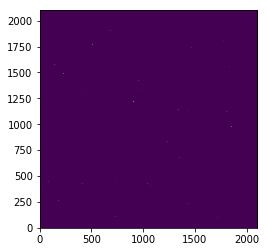

In [3]:
plt.imshow(image, origin='lower')
plt.show()

In [4]:
#clip values that are too large
clipped_image = np.clip(image, 0, np.mean(image)+0.1*np.std(image))
#scale by squaring pixel values
image_scale = np.power(clipped_image, 2)

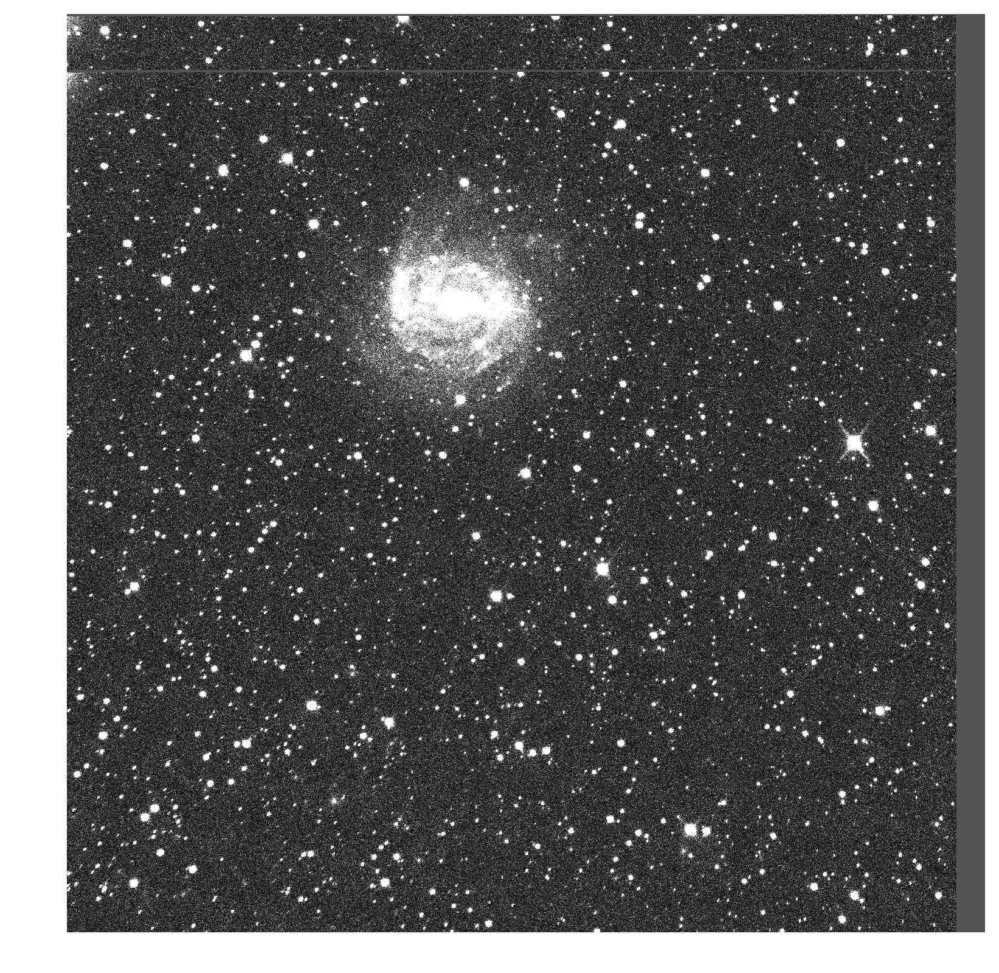

In [5]:
plt.figure(figsize=(10,10), dpi=200)
plt.imshow(image_scale, origin='lower', cmap='gray')
plt.axis('off')
plt.savefig('object.png')
plt.show()

In [6]:
catalogfile = os.path.join(os.getcwd(), 'object.cat')
catalog = np.loadtxt(catalogfile)

In [7]:
x = catalog[:,5]
y = catalog[:, 6]
flags = catalog[:, -1]

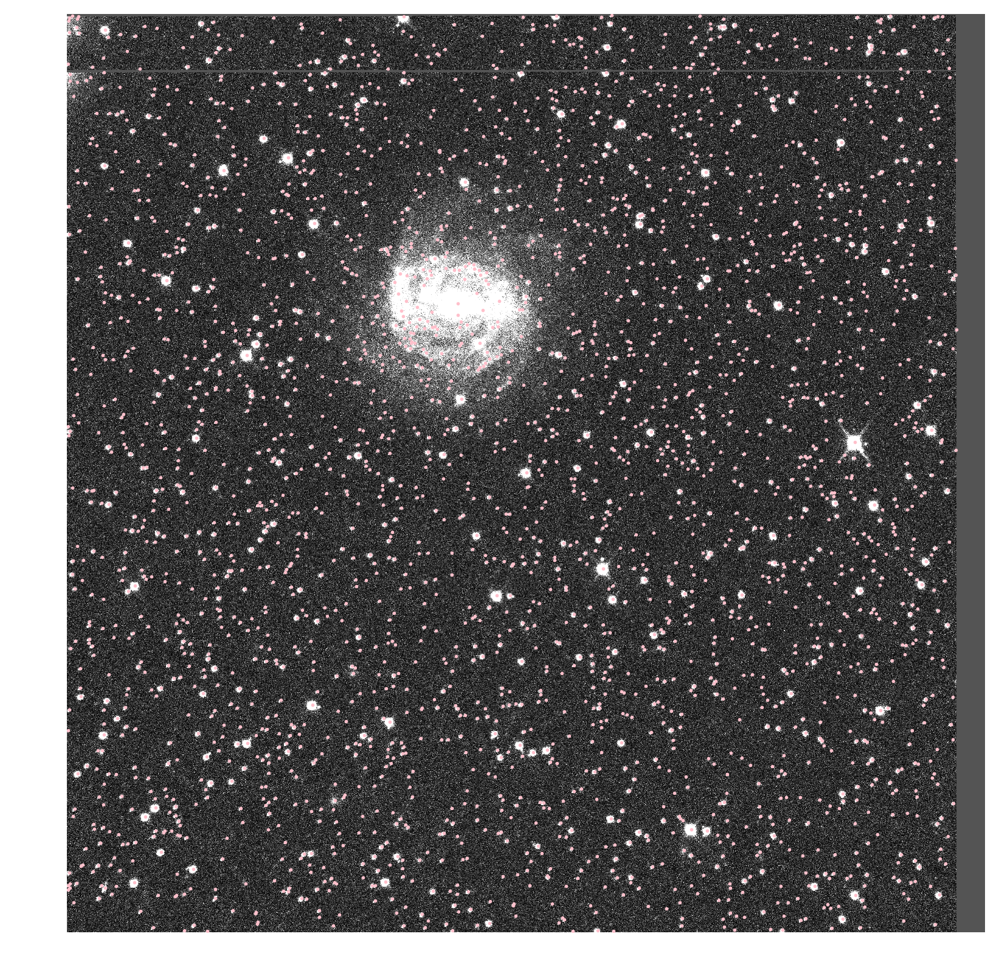

In [8]:
#plot stars from catalog on top of image
plt.figure(figsize=(10,10), dpi=200)
plt.plot(x, y, '.', color='pink', markersize=2)
plt.imshow(image_scale, origin='lower', cmap='gray')
plt.axis('off')
plt.savefig('object.png')
plt.show()

In [9]:
no_flag_indices = np.where(flags==0)

no_flag_x = x[no_flag_indices]
no_flag_y = y[no_flag_indices]

flag_x = x[flags!=0]
flag_y = y[flags!=0]

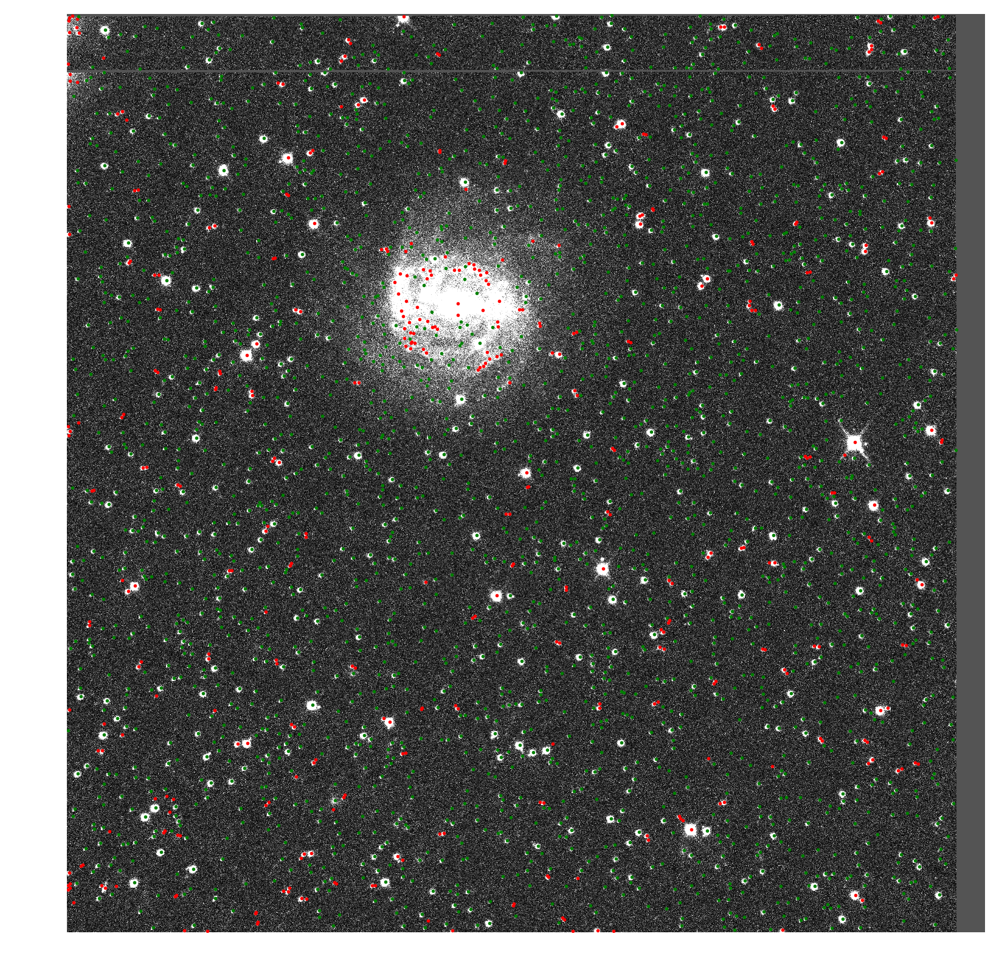

In [10]:
#plot stars on top of image again
#flagged stars are red, unflagged stars are green
plt.figure(figsize=(10,10), dpi=200)
plt.imshow(image_scale, origin='lower', cmap='gray')
plt.plot(flag_x,flag_y,'r.', markersize=2)
plt.plot(no_flag_x,no_flag_y,'g.', markersize=2)
plt.axis('off')
plt.show()

The stars with no flag (red) tend to be clustered in the galaxy in the upper center of the image, while the flagged stars seem to be randomly distributed in space. This suggests flag stars are ones with high count values. From the manual, it looks like flags are assigned to stars with unreliable measurements due to saturation of pixels, overflow, other stars that are very close, etc.

In [11]:
np.random.seed(42)

flux = catalog[:,1]

#randomly choose 1000 non-flagged stars
num_indices = 1000
random_no_flag_indices = np.random.randint(0, len(no_flag_x), num_indices)

flux_no_flag = flux[no_flag_indices]
random_flux_no_flag = flux_no_flag[random_no_flag_indices]

In [12]:
#get maximum count value near location (x, y) in image
def get_max(x, y, image, radius):
    #no stars within 2 pixels of border
    box = image[y-radius:y+radius+1, x-radius:x+radius+1]
    max_count = np.amax(box)
    return max_count

no_flag_max_counts = np.zeros(num_indices)

#find max count for each no-flag star
for idx, no_flag_idx in enumerate(random_no_flag_indices):
    xval_no_flag = no_flag_x[no_flag_idx]
    yval_no_flag = no_flag_y[no_flag_idx]
    max_count = get_max(int(xval_no_flag), int(yval_no_flag), image, 2)
    no_flag_max_counts[idx] = max_count

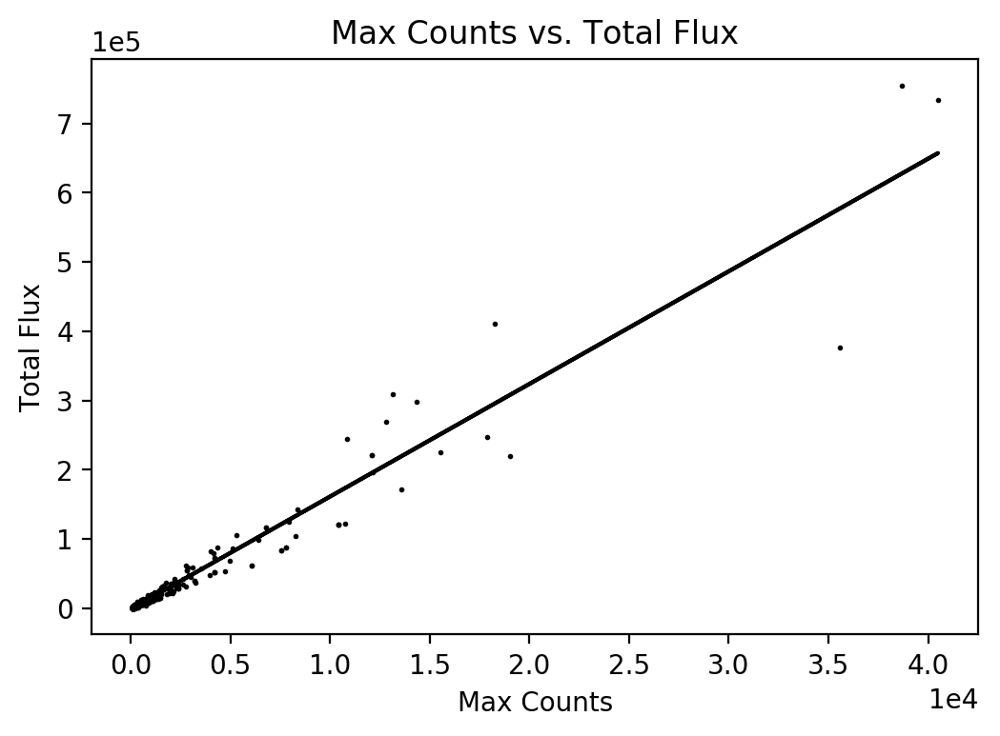

coefficients:  [   16.26189193 -1248.44601304]


In [13]:
#fit a line to the counts vs. flux data
coeffs = np.polyfit(no_flag_max_counts, random_flux_no_flag, 1)

#plot counts vs. flux along with fit line
plt.figure(dpi=200)
plt.ticklabel_format(style='sci',  axis='both', scilimits=(0,0))
plt.plot(no_flag_max_counts, random_flux_no_flag, 'k.', markersize=2)
plt.plot(no_flag_max_counts, coeffs[0]*no_flag_max_counts+coeffs[1], 'k')
plt.xlabel("Max Counts")
plt.ylabel("Total Flux")
plt.title("Max Counts vs. Total Flux")
plt.show()

print("coefficients: ", coeffs)

The relationship looks linear  
The relationship is approximately flux = 16 * count - 1200

In [14]:
#find x, y, and flux for the 8 stars in flux range 1990 to 2010
flux_indices_8star = np.where((flux <= 2010) * (flux >= 1990))
x_8star = x[flux_indices_8star]
y_8star = y[flux_indices_8star]
print("x coordinates: ", x_8star)
print("y coordinates: ", y_8star)

#find max counts for the 8 stars
star8_max_counts = np.zeros(8)
for idx, (x_8star, y_8star) in enumerate(zip(x_8star, y_8star)):
    max_count = get_max(int(x_8star), int(y_8star), image, 2)
    star8_max_counts[idx] = max_count
    
#actual standard deviation and our estimate
star8_std = np.std(star8_max_counts)
star8_std_est = np.sqrt(np.mean(star8_max_counts))

print("counts: ", star8_max_counts)
print("standard deviation: ", star8_std)
print("expected error: ", star8_std_est)

x coordinates:  [1141.329    83.8793  119.0243 1838.8741  682.637    98.6498   18.404
  176.9869]
y coordinates:  [ 216.6277  476.1815  828.0883  894.3839 1076.4844 1828.0398 1287.281
 2071.1746]
counts:  [134.91569519 121.36032867 119.97554779 436.95620728 176.39396667
 145.6736145  131.20982361 164.79049683]
standard deviation:  99.306490983607
expected error:  13.375704096149445


We expect an uncertainty of sqrt(N) for each count, so if we assume all of the stars have the same actual flux, we expect the standard deviation to be somewhere around the square root of the mean of the 8 counts.

The standard deviation is larger than we expect. This could be due to high background compared to the signal (low signal-to-noise ratio). From ds9 it looks like the background values range from around 0 to 60, and the counts have a mean of 180 (with an outlier at 437).

Also, we looked at stars with a range of total fluxes. Some of the variation is due to to the fact that we are measuring stars with different actual fluxes.

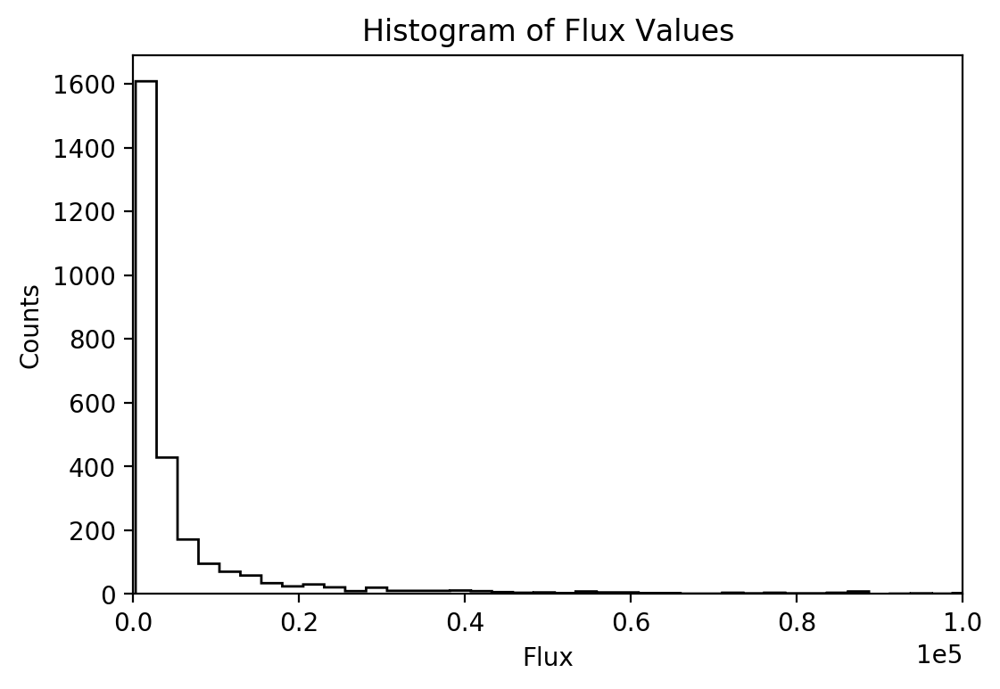

In [15]:
plt.figure(dpi=200)
plt.ticklabel_format(style='sci',  axis='x', scilimits=(0,0))
plt.hist(flux, bins=1000, histtype='step', color='k')
plt.xlabel("Flux")
plt.ylabel("Counts")
plt.xlim([0, 1e5])
plt.title("Histogram of Flux Values")
plt.show()

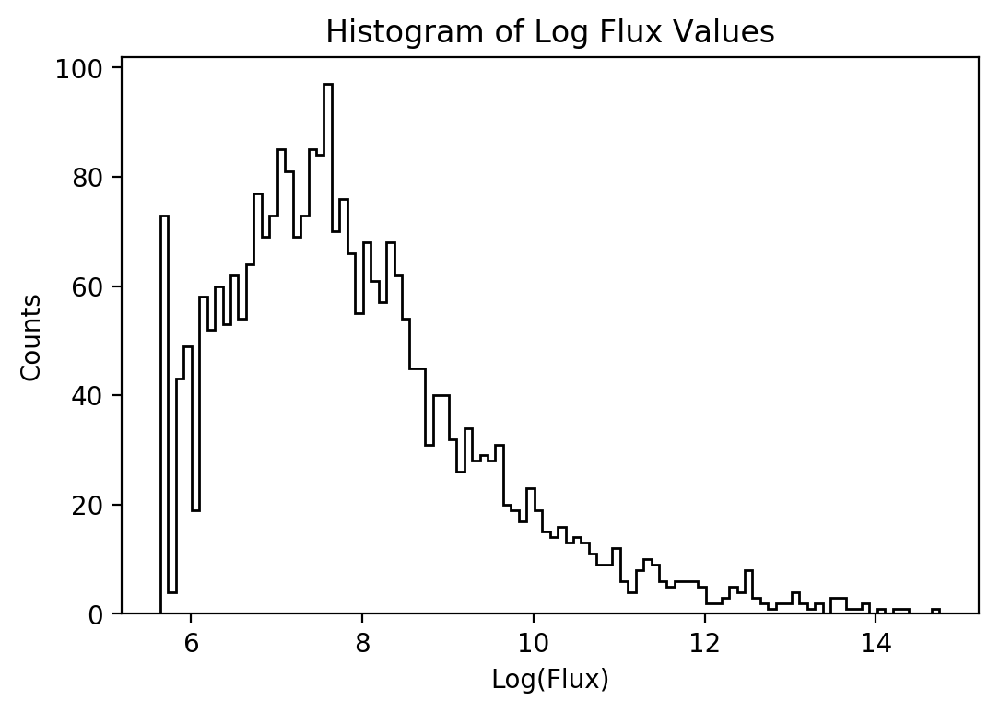

In [16]:
plt.figure(dpi=200)
plt.hist(np.log(flux), bins=100, histtype='step', color='k')
plt.xlabel("Log(Flux)")
plt.ylabel("Counts")
plt.title("Histogram of Log Flux Values")
plt.show()

The log histogram is better because the number of observations fall off quickly as flux increases.  
The log histogram lets us see how the number of observations fall off instead of just a spike close to 0.